<h1>Final Project: Dynamic Pricing Of Airfare</h1>
<h2>AIT 614-002 </h2>
<h3> Professor Ben duan </h3>


The Project is about finding a dynamics of air fare prices and feature importance which could be further utilised for reinforcement learning. <br>


<h5>Team 7</h5>
- Ankush Dilip Tonde<br>
- Charanteja Vallabhaneni<br>
- Sumukh Bharadvaja Shivaram<br>

In [0]:
%pip install xgboost

Python interpreter will be restarted.
Python interpreter will be restarted.


In [0]:
df1 = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/sbharadv@gmu.edu/Cleaned_dataset.csv")

In [0]:
display(df1)

Date_of_journey,Journey_day,Airline,Flight_code,Class,Source,Departure,Total_stops,Arrival,Destination,Duration_in_hours,Days_left,Fare
2023-01-16,Monday,SpiceJet,SG-8169,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.0833,1,5335
2023-01-16,Monday,Indigo,6E-2519,Economy,Delhi,After 6 PM,non-stop,Before 6 AM,Mumbai,2.3333,1,5899
2023-01-16,Monday,GO FIRST,G8-354,Economy,Delhi,After 6 PM,non-stop,Before 6 AM,Mumbai,2.1667,1,5801
2023-01-16,Monday,SpiceJet,SG-8709,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.0833,1,5794
2023-01-16,Monday,Air India,AI-805,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.1667,1,5955
2023-01-16,Monday,Air India,AI-605,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.25,1,5955
2023-01-16,Monday,Air India,AI-814,Economy,Delhi,After 6 PM,non-stop,Before 6 AM,Mumbai,2.25,1,5955
2023-01-16,Monday,GO FIRST,G8-330,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.25,1,5899
2023-01-16,Monday,SpiceJet,SG-2976,Economy,Delhi,After 6 PM,1-stop,6 AM - 12 PM,Mumbai,14.3333,1,5829
2023-01-16,Monday,GO FIRST,G8-346,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.0833,1,5899


For checking missing columns using spark , we are creating a dictionay 

In [0]:
missing_counts = {col: df1.filter(df1[col].isNull()).count() for col in df1.columns}
missing_counts

Out[3]: {'Date_of_journey': 0,
 'Journey_day': 0,
 'Airline': 0,
 'Flight_code': 0,
 'Class': 0,
 'Source': 0,
 'Departure': 0,
 'Total_stops': 0,
 'Arrival': 0,
 'Destination': 0,
 'Duration_in_hours': 0,
 'Days_left': 0,
 'Fare': 0}

Since there are no missing values we can proceed with the Exploratory Data Analysis

In [0]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import col
from pyspark.sql.types import DateType, FloatType, IntegerType



# Converting the datatypes
df1 = df1.withColumn("Date_of_journey", col("Date_of_journey").cast(DateType())) \
         .withColumn("Duration_in_hours", col("Duration_in_hours").cast(FloatType())) \
         .withColumn("Days_left", col("Days_left").cast(IntegerType())) \
         .withColumn("Fare", col("Fare").cast(IntegerType()))

#  the updated DataFrame with proper data types
df1.printSchema()



root
 |-- Date_of_journey: date (nullable = true)
 |-- Journey_day: string (nullable = true)
 |-- Airline: string (nullable = true)
 |-- Flight_code: string (nullable = true)
 |-- Class: string (nullable = true)
 |-- Source: string (nullable = true)
 |-- Departure: string (nullable = true)
 |-- Total_stops: string (nullable = true)
 |-- Arrival: string (nullable = true)
 |-- Destination: string (nullable = true)
 |-- Duration_in_hours: float (nullable = true)
 |-- Days_left: integer (nullable = true)
 |-- Fare: integer (nullable = true)



In [0]:
display(df1)

Date_of_journey,Journey_day,Airline,Flight_code,Class,Source,Departure,Total_stops,Arrival,Destination,Duration_in_hours,Days_left,Fare
2023-01-16,Monday,SpiceJet,SG-8169,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.0833,1,5335
2023-01-16,Monday,Indigo,6E-2519,Economy,Delhi,After 6 PM,non-stop,Before 6 AM,Mumbai,2.3333,1,5899
2023-01-16,Monday,GO FIRST,G8-354,Economy,Delhi,After 6 PM,non-stop,Before 6 AM,Mumbai,2.1667,1,5801
2023-01-16,Monday,SpiceJet,SG-8709,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.0833,1,5794
2023-01-16,Monday,Air India,AI-805,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.1667,1,5955
2023-01-16,Monday,Air India,AI-605,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.25,1,5955
2023-01-16,Monday,Air India,AI-814,Economy,Delhi,After 6 PM,non-stop,Before 6 AM,Mumbai,2.25,1,5955
2023-01-16,Monday,GO FIRST,G8-330,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.25,1,5899
2023-01-16,Monday,SpiceJet,SG-2976,Economy,Delhi,After 6 PM,1-stop,6 AM - 12 PM,Mumbai,14.3333,1,5829
2023-01-16,Monday,GO FIRST,G8-346,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.0833,1,5899


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

<h2>Key Findings</h2>
1. <b>Price Range Variation:</b> Different airlines show distinct pricing strategies. Some cater to higher-end markets, while others seem to focus on more budget-friendly options.<br>
2. <b>Average Prices:</b> The positioning of average prices indicates skewed distributions for some airlines, which may reflect a variety of ticket options and service levels.<br>
3. <b>Low vs. High Price Points:</b> The minimal gap between the minimum and Q1 prices for certain airlines suggests a focus on competitive pricing. A higher Q3 can indicate premium ticket offerings.<br>
4. <b>Consistency in Pricing:</b> Some airlines maintain consistent pricing, as seen by the close proximity of their Q1, median, and Q3 values. The airlines which offer higher rates has very small window for consistency. This maybe due to class.<br> 
5. <b>Potential Outliers:</b> Disparities between the average and median prices point to potential outliers, influencing overall price perceptions.<br>
6. <b>Competitive Analysis:</b> The plot provides valuable insights into the competitive landscape of the airline industry, showing how different companies position themselves in the market.<br>
7. <b>Consumer Choice:</b> The data suggests which airlines may be preferred by cost-conscious travelers versus those seeking premium services.


In [0]:
display(df1)

Date_of_journey,Journey_day,Airline,Flight_code,Class,Source,Departure,Total_stops,Arrival,Destination,Duration_in_hours,Days_left,Fare
2023-01-16,Monday,SpiceJet,SG-8169,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.0833,1,5335
2023-01-16,Monday,Indigo,6E-2519,Economy,Delhi,After 6 PM,non-stop,Before 6 AM,Mumbai,2.3333,1,5899
2023-01-16,Monday,GO FIRST,G8-354,Economy,Delhi,After 6 PM,non-stop,Before 6 AM,Mumbai,2.1667,1,5801
2023-01-16,Monday,SpiceJet,SG-8709,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.0833,1,5794
2023-01-16,Monday,Air India,AI-805,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.1667,1,5955
2023-01-16,Monday,Air India,AI-605,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.25,1,5955
2023-01-16,Monday,Air India,AI-814,Economy,Delhi,After 6 PM,non-stop,Before 6 AM,Mumbai,2.25,1,5955
2023-01-16,Monday,GO FIRST,G8-330,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.25,1,5899
2023-01-16,Monday,SpiceJet,SG-2976,Economy,Delhi,After 6 PM,1-stop,6 AM - 12 PM,Mumbai,14.3333,1,5829
2023-01-16,Monday,GO FIRST,G8-346,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.0833,1,5899


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

In [0]:
display(df1)

Date_of_journey,Journey_day,Airline,Flight_code,Class,Source,Departure,Total_stops,Arrival,Destination,Duration_in_hours,Days_left,Fare
2023-01-16,Monday,SpiceJet,SG-8169,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.0833,1,5335
2023-01-16,Monday,Indigo,6E-2519,Economy,Delhi,After 6 PM,non-stop,Before 6 AM,Mumbai,2.3333,1,5899
2023-01-16,Monday,GO FIRST,G8-354,Economy,Delhi,After 6 PM,non-stop,Before 6 AM,Mumbai,2.1667,1,5801
2023-01-16,Monday,SpiceJet,SG-8709,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.0833,1,5794
2023-01-16,Monday,Air India,AI-805,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.1667,1,5955
2023-01-16,Monday,Air India,AI-605,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.25,1,5955
2023-01-16,Monday,Air India,AI-814,Economy,Delhi,After 6 PM,non-stop,Before 6 AM,Mumbai,2.25,1,5955
2023-01-16,Monday,GO FIRST,G8-330,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.25,1,5899
2023-01-16,Monday,SpiceJet,SG-2976,Economy,Delhi,After 6 PM,1-stop,6 AM - 12 PM,Mumbai,14.3333,1,5829
2023-01-16,Monday,GO FIRST,G8-346,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.0833,1,5899


Databricks visualization. Run in Databricks to view.

In [0]:
df_filtered = df1.drop('Date_of_journey', 'Flight_code')

# Showing the top rows of the updated DataFrame

In [0]:
df_filtered.printSchema()

root
 |-- Journey_day: string (nullable = true)
 |-- Airline: string (nullable = true)
 |-- Class: string (nullable = true)
 |-- Source: string (nullable = true)
 |-- Departure: string (nullable = true)
 |-- Total_stops: string (nullable = true)
 |-- Arrival: string (nullable = true)
 |-- Destination: string (nullable = true)
 |-- Duration_in_hours: float (nullable = true)
 |-- Days_left: integer (nullable = true)
 |-- Fare: integer (nullable = true)



In [0]:
df_filtered.display()

Journey_day,Airline,Class,Source,Departure,Total_stops,Arrival,Destination,Duration_in_hours,Days_left,Fare
Monday,SpiceJet,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.0833,1,5335
Monday,Indigo,Economy,Delhi,After 6 PM,non-stop,Before 6 AM,Mumbai,2.3333,1,5899
Monday,GO FIRST,Economy,Delhi,After 6 PM,non-stop,Before 6 AM,Mumbai,2.1667,1,5801
Monday,SpiceJet,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.0833,1,5794
Monday,Air India,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.1667,1,5955
Monday,Air India,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.25,1,5955
Monday,Air India,Economy,Delhi,After 6 PM,non-stop,Before 6 AM,Mumbai,2.25,1,5955
Monday,GO FIRST,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.25,1,5899
Monday,SpiceJet,Economy,Delhi,After 6 PM,1-stop,6 AM - 12 PM,Mumbai,14.3333,1,5829
Monday,GO FIRST,Economy,Delhi,After 6 PM,non-stop,After 6 PM,Mumbai,2.0833,1,5899


In [0]:
from pyspark.sql.functions import col, create_map, lit
from pyspark.ml.feature import StringIndexer
from pyspark.sql.types import StringType
from pyspark.ml import Pipeline
from itertools import chain

stops_mapping = {'non-stop': 0, '1-stop': 1, '2+-stop': 2}
mapping_expr = create_map([lit(x) for x in chain(*stops_mapping.items())])
df_filtered = df_filtered.withColumn('Total_stops', mapping_expr.getItem(col('Total_stops')))

# Get a list of columns, check their data types, and apply label encoding
categoricalColumns = [col for col in df_filtered.columns if col != 'Total_stops' and df_filtered.schema[col].dataType == StringType()]

# Use StringIndexer to convert string labels to numeric indices
indexers = [StringIndexer(inputCol=column, outputCol=column + "_index") for column in categoricalColumns]
pipeline = Pipeline(stages=indexers)
df_filtered = pipeline.fit(df_filtered).transform(df_filtered)

# Replace original columns with indexed columns
for column in categoricalColumns:
    df_filtered = df_filtered.drop(column).withColumnRenamed(column + "_index", column)

# Print the mappings for each column
for indexer, column in zip(indexers, categoricalColumns):
    model = indexer.fit(df1)  # Fit again to retrieve the label mappings
    labels = model.labels
    mapping = {label: idx for idx, label in enumerate(labels)}
    print(f"Column '{column}': {mapping}")





# Show the DataFrame after transformations
df_filtered.display()



/databricks/spark/python/pyspark/sql/column.py:466: FutureWarning: A column as 'key' in getItem is deprecated as of Spark 3.0, and will not be supported in the future release. Use `column[key]` or `column.key` syntax instead.
  warnings.warn(


Column 'Journey_day': {'Monday': 0, 'Thursday': 1, 'Friday': 2, 'Wednesday': 3, 'Tuesday': 4, 'Saturday': 5, 'Sunday': 6}
Column 'Airline': {'Vistara': 0, 'Air India': 1, 'Indigo': 2, 'AirAsia': 3, 'GO FIRST': 4, 'SpiceJet': 5, 'AkasaAir': 6, 'AllianceAir': 7, 'StarAir': 8}
Column 'Class': {'Economy': 0, 'Business': 1, 'Premium Economy': 2, 'First': 3}
Column 'Source': {'Delhi': 0, 'Mumbai': 1, 'Bangalore': 2, 'Hyderabad': 3, 'Chennai': 4, 'Kolkata': 5, 'Ahmedabad': 6}
Column 'Departure': {'6 AM - 12 PM': 0, 'After 6 PM': 1, '12 PM - 6 PM': 2, 'Before 6 AM': 3}
Column 'Arrival': {'After 6 PM': 0, '6 AM - 12 PM': 1, '12 PM - 6 PM': 2, 'Before 6 AM': 3}
Column 'Destination': {'Mumbai': 0, 'Delhi': 1, 'Bangalore': 2, 'Hyderabad': 3, 'Chennai': 4, 'Kolkata': 5, 'Ahmedabad': 6}


Total_stops,Duration_in_hours,Days_left,Fare,Journey_day,Airline,Class,Source,Departure,Arrival,Destination
0,2.0833,1,5335,0.0,5.0,0.0,0.0,1.0,0.0,0.0
0,2.3333,1,5899,0.0,2.0,0.0,0.0,1.0,3.0,0.0
0,2.1667,1,5801,0.0,4.0,0.0,0.0,1.0,3.0,0.0
0,2.0833,1,5794,0.0,5.0,0.0,0.0,1.0,0.0,0.0
0,2.1667,1,5955,0.0,1.0,0.0,0.0,1.0,0.0,0.0
0,2.25,1,5955,0.0,1.0,0.0,0.0,1.0,0.0,0.0
0,2.25,1,5955,0.0,1.0,0.0,0.0,1.0,3.0,0.0
0,2.25,1,5899,0.0,4.0,0.0,0.0,1.0,0.0,0.0
1,14.3333,1,5829,0.0,5.0,0.0,0.0,1.0,1.0,0.0
0,2.0833,1,5899,0.0,4.0,0.0,0.0,1.0,0.0,0.0


In [0]:
columns=['Journey_day','Airline','Class','Source','Departure','Arrival','Destination']

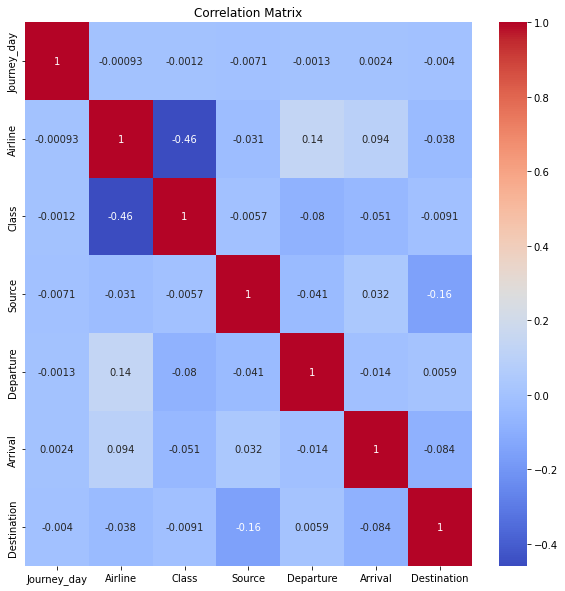

In [0]:

import matplotlib.pyplot as plt
import seaborn as sns
from pyspark.sql import SparkSession
from pyspark.ml.stat import Correlation
from pyspark.ml.feature import VectorAssembler

spark = SparkSession.builder \
    .appName("CorrelationPlot") \
    .getOrCreate()

# Convert columns to vector
assembler = VectorAssembler(inputCols=columns, outputCol="features")
df_vector = assembler.transform(df_filtered)

# Compute correlation matrix
correlation_matrix = Correlation.corr(df_vector, "features").head()

# Extract correlation matrix as a Pandas DataFrame
corr_matrix = correlation_matrix[0].toArray()

# Plot correlation matrix using Seaborn
plt.figure(figsize=(10, 10))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', xticklabels=columns, yticklabels=columns)
plt.title("Correlation Matrix")
plt.show()


In [0]:
from pyspark.sql import SparkSession
from pyspark.ml.regression import LinearRegression
from pyspark.ml.evaluation import RegressionEvaluator

# Initialize Spark Session
spark = SparkSession.builder.appName("Multiple Linear Regression Example").getOrCreate()

# Assuming 'df_filtered' is your DataFrame and it has already been preprocessed
# Assemble features if not already done and excluding 'Fare' which is our target
featureCols = [col for col in df_filtered.columns if col != 'Fare' and col != 'features']

if 'features' not in df_filtered.columns:
    assembler = VectorAssembler(inputCols=featureCols, outputCol="features")
    df_filtered = assembler.transform(df_filtered)

# Rename 'Fare' to 'label' for regression modeling
df_filtered = df_filtered.withColumnRenamed("Fare", "label")

# Split the data into training, validation, and testing sets
train_data, val_data, test_data = df_filtered.randomSplit([0.6, 0.2, 0.2], seed=42)

# Define the Linear Regression model
linear_model = LinearRegression(featuresCol='features', labelCol='label')

# Train the model on the training data
linear_model_fitted = linear_model.fit(train_data)

# Make predictions on training, validation, and test data
train_predictions = linear_model_fitted.transform(train_data)
val_predictions = linear_model_fitted.transform(val_data)
test_predictions = linear_model_fitted.transform(test_data)

# Set up evaluators for RMSE, R2, and MAE
evaluator = RegressionEvaluator(labelCol="label")
train_rmse_mlr = evaluator.evaluate(train_predictions, {evaluator.metricName: "rmse"})
train_r2_mlr = evaluator.evaluate(train_predictions, {evaluator.metricName: "r2"})
train_mae_mlr = evaluator.evaluate(train_predictions, {evaluator.metricName: "mae"})

val_rmse_mlr = evaluator.evaluate(val_predictions, {evaluator.metricName: "rmse"})
val_r2_mlr = evaluator.evaluate(val_predictions, {evaluator.metricName: "r2"})
val_mae_mlr= evaluator.evaluate(val_predictions, {evaluator.metricName: "mae"})

test_rmse_mlr = evaluator.evaluate(test_predictions, {evaluator.metricName: "rmse"})
test_r2_mlr = evaluator.evaluate(test_predictions, {evaluator.metricName: "r2"})
test_mae_mlr = evaluator.evaluate(test_predictions, {evaluator.metricName: "mae"})

# Print results
print("Training RMSE: ", train_rmse_mlr)
print("Training R2: ", train_r2_mlr)
print("Training MAE: ", train_mae_mlr)
print("Validation RMSE: ", val_rmse_mlr)
print("Validation R2: ", val_r2_mlr)
print("Validation MAE: ", val_mae_mlr)
print("Test RMSE: ", test_rmse_mlr)
print("Test R2: ", test_r2_mlr)
print("Test MAE: ", test_mae_mlr)


Training RMSE:  18175.915833413685
Training R2:  0.1994986559193871
Training MAE:  14090.411670698824
Validation RMSE:  18156.443140281335
Validation R2:  0.19718042559609072
Validation MAE:  14094.522106653794
Test RMSE:  18183.16558986001
Test R2:  0.20008947949895073
Test MAE:  14099.05789747907


In [0]:
df_filtered.display()

Total_stops,Duration_in_hours,Days_left,label,Journey_day,Airline,Class,Source,Departure,Arrival,Destination,features
0,2.0833,1,5335,0.0,5.0,0.0,0.0,1.0,0.0,0.0,"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7), values -> List(2.0833001136779785, 1.0, 5.0, 1.0))"
0,2.3333,1,5899,0.0,2.0,0.0,0.0,1.0,3.0,0.0,"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7, 8), values -> List(2.3333001136779785, 1.0, 2.0, 1.0, 3.0))"
0,2.1667,1,5801,0.0,4.0,0.0,0.0,1.0,3.0,0.0,"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7, 8), values -> List(2.1666998863220215, 1.0, 4.0, 1.0, 3.0))"
0,2.0833,1,5794,0.0,5.0,0.0,0.0,1.0,0.0,0.0,"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7), values -> List(2.0833001136779785, 1.0, 5.0, 1.0))"
0,2.1667,1,5955,0.0,1.0,0.0,0.0,1.0,0.0,0.0,"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7), values -> List(2.1666998863220215, 1.0, 1.0, 1.0))"
0,2.25,1,5955,0.0,1.0,0.0,0.0,1.0,0.0,0.0,"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7), values -> List(2.25, 1.0, 1.0, 1.0))"
0,2.25,1,5955,0.0,1.0,0.0,0.0,1.0,3.0,0.0,"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7, 8), values -> List(2.25, 1.0, 1.0, 1.0, 3.0))"
0,2.25,1,5899,0.0,4.0,0.0,0.0,1.0,0.0,0.0,"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7), values -> List(2.25, 1.0, 4.0, 1.0))"
1,14.3333,1,5829,0.0,5.0,0.0,0.0,1.0,1.0,0.0,"Map(vectorType -> dense, length -> 10, values -> List(1.0, 14.33329963684082, 1.0, 0.0, 5.0, 0.0, 0.0, 1.0, 1.0, 0.0))"
0,2.0833,1,5899,0.0,4.0,0.0,0.0,1.0,0.0,0.0,"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7), values -> List(2.0833001136779785, 1.0, 4.0, 1.0))"


In [0]:
display(df_filtered.select('features'))

features
"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7), values -> List(2.0833001136779785, 1.0, 5.0, 1.0))"
"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7, 8), values -> List(2.3333001136779785, 1.0, 2.0, 1.0, 3.0))"
"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7, 8), values -> List(2.1666998863220215, 1.0, 4.0, 1.0, 3.0))"
"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7), values -> List(2.0833001136779785, 1.0, 5.0, 1.0))"
"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7), values -> List(2.1666998863220215, 1.0, 1.0, 1.0))"
"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7), values -> List(2.25, 1.0, 1.0, 1.0))"
"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7, 8), values -> List(2.25, 1.0, 1.0, 1.0, 3.0))"
"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7), values -> List(2.25, 1.0, 4.0, 1.0))"
"Map(vectorType -> dense, length -> 10, values -> List(1.0, 14.33329963684082, 1.0, 0.0, 5.0, 0.0, 0.0, 1.0, 1.0, 0.0))"
"Map(vectorType -> sparse, length -> 10, indices -> List(1, 2, 4, 7), values -> List(2.0833001136779785, 1.0, 4.0, 1.0))"


In [0]:
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.regression import DecisionTreeRegressor
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.sql import SparkSession

# Create or get the Spark session
spark = SparkSession.builder.appName("DecisionTreeRegressionExample").getOrCreate()

featureCols = [col for col in df_filtered.columns if col != 'label' and col != 'features']

if 'features' not in df_filtered.columns:
    assembler = VectorAssembler(inputCols=featureCols, outputCol="features")
    df_filtered = assembler.transform(df_filtered)

# Rename 'Fare' to 'label' for regression modeling
df_filtered = df_filtered.withColumnRenamed("Fare", "label")


# Define the target column
df_filtered = df_filtered.withColumnRenamed("Fare", "label")

# Splitting the data into training (60%), validation (20%), and testing (20%) sets
train_data, val_data, test_data = df_filtered.randomSplit([0.6, 0.2, 0.2], seed=42)

# Setting up the decision tree regression model
dt = DecisionTreeRegressor(featuresCol="features", labelCol="label")

# Fitting the model on training data
dtModel = dt.fit(train_data)

# Making predictions on train, validation, and test data
train_predictions_dt = dtModel.transform(train_data)
val_predictions_dt = dtModel.transform(val_data)
test_predictions_dt = dtModel.transform(test_data)

# Setting up evaluators for RMSE, R2, and MAE
rmse_evaluator_dt = RegressionEvaluator(metricName="rmse")
r2_evaluator_dt = RegressionEvaluator(metricName="r2")
mae_evaluator_dt = RegressionEvaluator(metricName="mae")

# Evaluating the model on training data
train_rmse_dt = rmse_evaluator_dt.evaluate(train_predictions_dt)
train_r2_dt = r2_evaluator_dt.evaluate(train_predictions_dt)
train_mae_dt = mae_evaluator_dt.evaluate(train_predictions_dt)

# Evaluating the model on validation data
val_rmse_dt = rmse_evaluator_dt.evaluate(val_predictions_dt)
val_r2_dt = r2_evaluator_dt.evaluate(val_predictions_dt)
val_mae_dt = mae_evaluator_dt.evaluate(val_predictions_dt)

# Evaluating the model on test data
test_rmse_dt = rmse_evaluator_dt.evaluate(test_predictions_dt)
test_r2_dt = r2_evaluator_dt.evaluate(test_predictions_dt)
test_mae_dt = mae_evaluator_dt.evaluate(test_predictions_dt)

# Printing the results
print("Training RMSE (DT): ", train_rmse_dt)
print("Training R2 (DT): ", train_r2_dt)
print("Training MAE (DT): ", train_mae_dt)
print("Validation RMSE (DT): ", val_rmse_dt)
print("Validation R2 (DT): ", val_r2_dt)
print("Validation MAE (DT): ", val_mae_dt)
print("Test RMSE (DT): ", test_rmse_dt)
print("Test R2 (DT): ", test_r2_dt)
print("Test MAE (DT): ", test_mae_dt)

# Decision Tree
print("Decision Tree Model (feature importances and tree structure):")
print(dtModel.toDebugString)



Training RMSE (DT):  7082.488345748996
Training R2 (DT):  0.8784538529037892
Training MAE (DT):  4464.496845129268
Validation RMSE (DT):  7068.44477216823
Validation R2 (DT):  0.8783242188008199
Validation MAE (DT):  4446.305050391869
Test RMSE (DT):  7132.504371164154
Test R2 (DT):  0.8769202758704162
Test MAE (DT):  4489.603691149034
Decision Tree Model (feature importances and tree structure):
DecisionTreeRegressionModel: uid=DecisionTreeRegressor_3331f570c4e1, depth=5, numNodes=63, numFeatures=10
  If (feature 5 in {0.0,2.0})
   If (feature 5 in {0.0})
    If (feature 4 in {2.0,3.0,4.0,5.0,6.0,7.0})
     If (feature 1 <= 2.2083499431610107)
      If (feature 9 in {0.0,1.0,2.0,3.0,4.0,6.0})
       Predict: 4063.294285007422
      Else (feature 9 not in {0.0,1.0,2.0,3.0,4.0,6.0})
       Predict: 7351.181818181818
     Else (feature 1 > 2.2083499431610107)
      If (feature 2 <= 14.5)
       Predict: 10442.905311305298
      Else (feature 2 > 14.5)
       Predict: 7694.526215571111
  

In [0]:
featureCols

Out[18]: ['Total_stops',
 'Duration_in_hours',
 'Days_left',
 'Journey_day',
 'Airline',
 'Class',
 'Source',
 'Departure',
 'Arrival',
 'Destination']

In [0]:
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.regression import RandomForestRegressor
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.sql import SparkSession

# Create or get the Spark session
spark = SparkSession.builder.appName("RandomForestRegressionExample").getOrCreate()


featureCols = [col for col in df_filtered.columns if col != 'label' and col != 'features']


if 'features' not in df_filtered.columns:
    assembler = VectorAssembler(inputCols=featureCols, outputCol="features")
    df_filtered = assembler.transform(df_filtered)

df_filtered = df_filtered.withColumnRenamed("Fare", "label")


train_data, val_data, test_data = df_filtered.randomSplit([0.6, 0.2, 0.2], seed=42)

# Setting up the random forest regression model
rf = RandomForestRegressor(featuresCol="features", labelCol="label")

# Fitting the model on training data
rfModel = rf.fit(train_data)

# Making predictions on train, validation, and test data
train_predictions = rfModel.transform(train_data)
val_predictions = rfModel.transform(val_data)
test_predictions = rfModel.transform(test_data)

# Setting up evaluators for RMSE, R2, and MAE
rmse_evaluator = RegressionEvaluator(metricName="rmse")
r2_evaluator = RegressionEvaluator(metricName="r2")
mae_evaluator = RegressionEvaluator(metricName="mae")

# Evaluating the model on training data
train_rmse_rf = rmse_evaluator.evaluate(train_predictions)
train_r2_rf = r2_evaluator.evaluate(train_predictions)
train_mae_rf = mae_evaluator.evaluate(train_predictions)

# Evaluating the model on validation data
val_rmse_rf = rmse_evaluator.evaluate(val_predictions)
val_r2_rf = r2_evaluator.evaluate(val_predictions)
val_mae_rf = mae_evaluator.evaluate(val_predictions)

# Evaluating the model on test data
test_rmse_rf = rmse_evaluator.evaluate(test_predictions)
test_r2_rf = r2_evaluator.evaluate(test_predictions)
test_mae_rf = mae_evaluator.evaluate(test_predictions)

# Print tht results
print("Training RMSE: ", train_rmse_rf)
print("Training R2: ", train_r2_rf)
print("Training MAE: ", train_mae_rf)
print("Validation RMSE: ", val_rmse_rf)
print("Validation R2: ", val_r2_rf)
print("Validation MAE: ", val_mae_rf)
print("Test RMSE: ", test_rmse_rf)
print("Test R2: ", test_r2_rf)
print("Test MAE: ", test_mae_rf)


featureImportances = rfModel.featureImportances.toArray()
print("Feature Importances:", list(zip(featureCols, featureImportances)))


Training RMSE:  7313.976846969591
Training R2:  0.8703786256306209
Training MAE:  4547.8993724775755
Validation RMSE:  7283.425728122319
Validation R2:  0.8708103276085677
Validation MAE:  4527.948115518633
Test RMSE:  7343.565978310304
Test R2:  0.8695282692538255
Test MAE:  4571.115845110347
Feature Importances: [('Total_stops', 0.023645517325360264), ('Duration_in_hours', 0.04146357085142794), ('Days_left', 0.008278060647168309), ('Journey_day', 2.885146703446923e-06), ('Airline', 0.08682597046772819), ('Class', 0.8291078496479717), ('Source', 0.004746588868909491), ('Departure', 0.0004023674609384419), ('Arrival', 0.0013249361645309905), ('Destination', 0.004202253419261221)]


In [0]:
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.regression import GBTRegressor
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.sql import SparkSession

# Create or get the Spark session
spark = SparkSession.builder.appName("GradientBoostingRegressionExample").getOrCreate()

featureCols = [col for col in df_filtered.columns if col != 'label' and col != 'features']

if 'features' not in df_filtered.columns:
    assembler = VectorAssembler(inputCols=featureCols, outputCol="features")
    df_filtered = assembler.transform(df_filtered)

df_filtered = df_filtered.withColumnRenamed("Fare", "label")

train_data, val_data, test_data = df_filtered.randomSplit([0.6, 0.2, 0.2], seed=42)

# Setting up the Gradient Boosted Trees regression model
gbt = GBTRegressor(featuresCol="features", labelCol="label", maxIter=10)  # maxIter is the number of trees

gbtModel = gbt.fit(train_data)

train_predictions_gbt = gbtModel.transform(train_data)
val_predictions_gbt = gbtModel.transform(val_data)
test_predictions_gbt = gbtModel.transform(test_data)

rmse_evaluator_gbt = RegressionEvaluator(metricName="rmse")
r2_evaluator_gbt = RegressionEvaluator(metricName="r2")
mae_evaluator_gbt = RegressionEvaluator(metricName="mae")

# Evaluating the model on training data
train_rmse_gbt = rmse_evaluator_gbt.evaluate(train_predictions_gbt)
train_r2_gbt = r2_evaluator_gbt.evaluate(train_predictions_gbt)
train_mae_gbt = mae_evaluator_gbt.evaluate(train_predictions_gbt)

# Evaluating the model on validation data
val_rmse_gbt = rmse_evaluator_gbt.evaluate(val_predictions_gbt)
val_r2_gbt = r2_evaluator_gbt.evaluate(val_predictions_gbt)
val_mae_gbt = mae_evaluator_gbt.evaluate(val_predictions_gbt)

# Evaluating the model on test data
test_rmse_gbt = rmse_evaluator_gbt.evaluate(test_predictions_gbt)
test_r2_gbt = r2_evaluator_gbt.evaluate(test_predictions_gbt)
test_mae_gbt = mae_evaluator_gbt.evaluate(test_predictions_gbt)

print("Training RMSE (GBT): ", train_rmse_gbt)
print("Training R2 (GBT): ", train_r2_gbt)
print("Training MAE (GBT): ", train_mae_gbt)
print("Validation RMSE (GBT): ", val_rmse_gbt)
print("Validation R2 (GBT): ", val_r2_gbt)
print("Validation MAE (GBT): ", val_mae_gbt)
print("Test RMSE (GBT): ", test_rmse_gbt)
print("Test R2 (GBT): ", test_r2_gbt)
print("Test MAE (GBT): ", test_mae_gbt)


featureImportances_gbt = gbtModel.featureImportances.toArray()
print("Feature Importances (GBT):", list(zip(featureCols, featureImportances_gbt)))


Training RMSE (GBT):  6573.649756875589
Training R2 (GBT):  0.8952913447791226
Training MAE (GBT):  4042.7892559421875
Validation RMSE (GBT):  6571.2036929267
Validation R2 (GBT):  0.8948410443911964
Validation MAE (GBT):  4036.515913067346
Test RMSE (GBT):  6632.8227604596495
Test R2 (GBT):  0.8935613871525107
Test MAE (GBT):  4077.163751126638
Feature Importances (GBT): [('Total_stops', 0.041564560079169796), ('Duration_in_hours', 0.021565829484617636), ('Days_left', 0.031673954355700286), ('Journey_day', 0.0008852746049534532), ('Airline', 0.029250994300510594), ('Class', 0.7750138954181138), ('Source', 0.042327222389109395), ('Departure', 0.006550693505468399), ('Arrival', 0.01833052797850082), ('Destination', 0.03283704788385584)]


In [0]:
df_filtered

Out[21]: DataFrame[Total_stops: int, Duration_in_hours: float, Days_left: int, label: int, Journey_day: double, Airline: double, Class: double, Source: double, Departure: double, Arrival: double, Destination: double, features: vector]

In [0]:
import xgboost as xgb
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split


pandas_df = df_filtered.toPandas()


# Split features and labels
X = pandas_df.drop(['label', 'features'], axis=1)
y = pandas_df['label']

# Split data into training, validation, and testing sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Convert data to DMatrix, a format XGBoost uses for efficient training
dtrain = xgb.DMatrix(X_train, label=y_train)
dval = xgb.DMatrix(X_val, label=y_val)
dtest = xgb.DMatrix(X_test, label=y_test)

# Define the model parameters
params = {
    'objective': 'reg:squarederror',  # Objective for regression tasks
    'max_depth': 5,                   # Max depth of the trees
    'alpha': 10,                      # L1 regularization term on weights
    'learning_rate': 0.1,             # Step size shrinkage used in update
    'n_estimators': 100               # Number of trees. Equivalent to num_boost_round in xgb.train()
}

# Train the model
num_rounds = 50
bst = xgb.train(params, dtrain, num_rounds)

# Predictions
train_preds = bst.predict(dtrain)
val_preds = bst.predict(dval)
test_preds = bst.predict(dtest)

# Evaluation metrics
train_rmse = mean_squared_error(y_train, train_preds, squared=False)
train_r2 = r2_score(y_train, train_preds)
train_mae = mean_absolute_error(y_train, train_preds)

val_rmse = mean_squared_error(y_val, val_preds, squared=False)
val_r2 = r2_score(y_val, val_preds)
val_mae = mean_absolute_error(y_val, val_preds)

test_rmse = mean_squared_error(y_test, test_preds, squared=False)
test_r2 = r2_score(y_test, test_preds)
test_mae = mean_absolute_error(y_test, test_preds)

# Print results
print("Training RMSE: ", train_rmse)
print("Training R2: ", train_r2)
print("Training MAE: ", train_mae)
print("Validation RMSE: ", val_rmse)
print("Validation R2: ", val_r2)
print("Validation MAE: ", val_mae)
print("Test RMSE: ", test_rmse)
print("Test R2: ", test_r2)
print("Test MAE: ", test_mae)



/databricks/spark/python/pyspark/sql/pandas/conversion.py:122: UserWarning: toPandas attempted Arrow optimization because 'spark.sql.execution.arrow.pyspark.enabled' is set to true; however, failed by the reason below:
  Unable to convert the field features. If this column is not necessary, you may consider dropping it or converting to primitive type before the conversion.
Direct cause: Unsupported type in conversion to Arrow: VectorUDT()
Attempting non-optimization as 'spark.sql.execution.arrow.pyspark.fallback.enabled' is set to true.
  warn(msg)
/local_disk0/.ephemeral_nfs/envs/pythonEnv-fac6751f-691c-444d-a992-3907ad9164fa/lib/python3.9/site-packages/xgboost/core.py:160: UserWarning: [16:16:45] WARNING: /workspace/src/learner.cc:742: 
Parameters: { "n_estimators" } are not used.

  warnings.warn(smsg, UserWarning)


Training RMSE:  6376.585457846659
Training R2:  0.9011112327102286
Training MAE:  3892.741033158533
Validation RMSE:  6444.1815011455865
Validation R2:  0.9003012086042343
Validation MAE:  3915.5957823793037
Test RMSE:  6381.090444716828
Test R2:  0.9011647066327808
Test MAE:  3904.6518910214013


In [0]:
from pyspark.sql.types import StructType, StructField, StringType, FloatType
from pyspark.sql import SparkSession

# Initialize Spark Session
spark = SparkSession.builder.appName("XGBoost Metrics").getOrCreate()

# Define the schema
schema = StructType([
    StructField("model", StringType(), True),
    StructField("dataset", StringType(), True),
    StructField("rmse", FloatType(), True),
    StructField("r2", FloatType(), True),
    StructField("mae", FloatType(), True)
])


In [0]:
from pyspark.sql import Row

# Assuming you have your metrics stored in variables as shown previously
data = [
    Row(model="XGBoost", dataset="Train", rmse=float(train_rmse), r2=float(train_r2), mae=float(train_mae)),
    Row(model="XGBoost", dataset="Validation", rmse=float(val_rmse), r2=float(val_r2), mae=float(val_mae)),
    Row(model="XGBoost", dataset="Test", rmse=float(test_rmse), r2=float(test_r2), mae=float(test_mae))
]

# Create DataFrame using the defined schema
metrics_df = spark.createDataFrame(data, schema=schema)

# Show DataFrame
metrics_df.show()



+-------+----------+---------+----------+---------+
|  model|   dataset|     rmse|        r2|      mae|
+-------+----------+---------+----------+---------+
|XGBoost|     Train|6376.5854|0.90111125| 3892.741|
|XGBoost|Validation|6444.1816| 0.9003012|3915.5957|
|XGBoost|      Test|6381.0903| 0.9011647|3904.6519|
+-------+----------+---------+----------+---------+



In [0]:
from pyspark.sql import SparkSession
from pyspark.sql import Row

# Initialize Spark Session
spark = SparkSession.builder.appName("Model Evaluation Metrics").getOrCreate()

# Create a dictionary with the results
data = [
    Row(model="MLR", dataset="Train", rmse=train_rmse_mlr, r2=train_r2_mlr, mae=train_mae_mlr),
    Row(model="MLR", dataset="Validation", rmse=val_rmse_mlr, r2=val_r2_mlr, mae=val_mae_mlr),
    Row(model="MLR", dataset="Test", rmse=test_rmse_mlr, r2=test_r2_mlr, mae=test_mae_mlr),
    Row(model="Decision Tree", dataset="Train", rmse=train_rmse_dt, r2=train_r2_dt, mae=train_mae_dt),
    Row(model="Decision Tree", dataset="Validation", rmse=val_rmse_dt, r2=val_r2_dt, mae=val_mae_dt),
    Row(model="Decision Tree", dataset="Test", rmse=test_rmse_dt, r2=test_r2_dt, mae=test_mae_dt),
    Row(model="Random Forest", dataset="Train", rmse=train_rmse_rf, r2=train_r2_rf, mae=train_mae_rf),
    Row(model="Random Forest", dataset="Validation", rmse=val_rmse_rf, r2=val_r2_rf, mae=val_mae_rf),
    Row(model="Random Forest", dataset="Test", rmse=test_rmse_rf, r2=test_r2_rf, mae=test_mae_rf),
    Row(model="Gradient Boost", dataset="Train", rmse=train_rmse_gbt, r2=train_r2_gbt, mae=train_mae_gbt),
    Row(model="Gradient Boost", dataset="Validation", rmse=val_rmse_gbt, r2=val_r2_gbt, mae=val_mae_gbt),
    Row(model="Gradient Boost", dataset="Test", rmse=test_rmse_gbt, r2=test_r2_gbt, mae=test_mae_gbt),
    Row(model="XGBoost", dataset="Train", rmse=float(train_rmse), r2=float(train_r2), mae=float(train_mae)),
    Row(model="XGBoost", dataset="Validation", rmse=float(val_rmse), r2=float(val_r2), mae=float(val_mae)),
    Row(model="XGBoost", dataset="Test", rmse=float(test_rmse), r2=float(test_r2), mae=float(test_mae))
    
]

# Create a DataFrame
df_results = spark.createDataFrame(data)

# Show the DataFrame
df_results.show()



+--------------+----------+------------------+-------------------+------------------+
|         model|   dataset|              rmse|                 r2|               mae|
+--------------+----------+------------------+-------------------+------------------+
|           MLR|     Train|18175.915833413685| 0.1994986559193871|14090.411670698824|
|           MLR|Validation|18156.443140281335|0.19718042559609072|14094.522106653794|
|           MLR|      Test| 18183.16558986001|0.20008947949895073| 14099.05789747907|
| Decision Tree|     Train| 7082.488345748996| 0.8784538529037892| 4464.496845129268|
| Decision Tree|Validation|  7068.44477216823| 0.8783242188008199| 4446.305050391869|
| Decision Tree|      Test| 7132.504371164154| 0.8769202758704162| 4489.603691149034|
| Random Forest|     Train| 7313.976846969591| 0.8703786256306209|4547.8993724775755|
| Random Forest|Validation| 7283.425728122319| 0.8708103276085677| 4527.948115518633|
| Random Forest|      Test| 7343.565978310304| 0.86952

In [0]:
display(df_results)

model,dataset,rmse,r2,mae
MLR,Train,18175.915833413685,0.1994986559193871,14090.411670698824
MLR,Validation,18156.443140281335,0.19718042559609072,14094.522106653794
MLR,Test,18183.16558986001,0.20008947949895073,14099.05789747907
Decision Tree,Train,7082.488345748996,0.8784538529037892,4464.496845129268
Decision Tree,Validation,7068.44477216823,0.8783242188008199,4446.305050391869
Decision Tree,Test,7132.504371164154,0.8769202758704162,4489.603691149034
Random Forest,Train,7313.976846969591,0.8703786256306209,4547.8993724775755
Random Forest,Validation,7283.425728122319,0.8708103276085677,4527.948115518633
Random Forest,Test,7343.565978310304,0.8695282692538255,4571.115845110347
Gradient Boost,Train,6573.649756875589,0.8952913447791226,4042.7892559421875


Databricks visualization. Run in Databricks to view.

<h2>Results and Discussion</h2>

<h2>Observations</h2>

<h3>Data Utilization and Modeling Techniques</h3>
<ul>
    <li><b>Employed extensive datasets from multiple airlines</b>, analyzing over 400k records with advanced data analytics techniques.</li>
    <li><b>Applied machine learning models</b> including Linear Regression, Decision Trees, Random Forest, Gradient Boosting, and XGBoost.</li>
</ul>

<h3>Performance Insights</h3>
<ul>
    <li><b>XGBoost emerged as the most effective model</b>, capturing approximately 91% of data variability with significant RMSE improvements.</li>
    <li><b>Decision Trees and Random Forests</b> demonstrated robust performance with an R2 score of around 87%.</li>
    <li><b>Overall Boosting algorithm</b> performed better than ensemble models with better RMSE metrics.</li>
</ul>

<h3>Conclusion</h3>
<ul>
    <li>The study highlights the <b>effectiveness of ensemble methods and boosting</b> in predicting dynamic pricing in the airline industry.</li>
    <li>Demonstrates potential for these models to <b>help airlines optimize pricing strategies</b> and enhance profitability while providing consumers with better price forecasting.</li>
</ul>



<h2>Feature Importance Analysis</h2>

<p>The Gradient Boosting Tree model reveals significant insights into the relative importance of features influencing airline pricing strategies:</p>

<ul>
    <li><b>Total_stops:</b> 4.16%</li>
    <li><b>Duration_in_hours:</b> 2.16%</li>
    <li><b>Days_left:</b> 3.17%</li>
    <li><b>Journey_day:</b> 0.09%</li>
    <li><b>Airline:</b> 2.93%</li>
    <li><b>Class:</b> 77.50%</li>
    <li><b>Source:</b> 4.23%</li>
    <li><b>Departure:</b> 0.65%</li>
    <li><b>Arrival:</b> 1.83%</li>
    <li><b>Destination:</b> 3.28%</li>
</ul>

<h2>Utilizing Features for Reinforcement Learning</h2>

<p>For the application of reinforcement learning (RL) in optimizing dynamic pricing strategies, the following features can be particularly influential:</p>

<ul>
    <li><b>Class:</b> With its significant impact on pricing, the class of service can be a primary reward signal in an RL model to maximize profitability based on customer preferences and booking behaviors.</li>
    <li><b>Total_stops and Duration_in_hours:</b> These features could be used to adjust route efficiency and travel time in the policy decisions, optimizing for both cost and traveler convenience.</li>
    <li><b>Days_left and Departure:</b> These temporal features can be crucial for learning when to offer promotional pricing or adjust rates based on the proximity to the departure date and time, potentially maximizing bookings.</li>
</ul>

<p>Integrating these features into an RL model could provide actionable insights and automated decision-making capabilities that adapt to evolving market conditions and consumer trends.</p>


<h2>References</h2>
<ul>
    <li><i>[1] Dr. Liao. Lab Instructions …</i></li>
    <li><i>[2] Dr. Liao. Lab code example</i></li>
    <li><i>[3] Dr Ben Duan Class Examples</i></li>
    <li><i>[4] Data Source: <a href="https://www.kaggle.com/datasets/yashdharme36/airfare-ml-predicting-flight-fares">https://www.kaggle.com/datasets/yashdharme36/airfare-ml-predicting-flight-fares</a></i></li>
    <li><i>[4] Databricks. SQL Language Reference, <a href="https://docs.databricks.com/en/sql/language-manual/index.html">https://docs.databricks.com/en/sql/language-manual/index.html</a>.</i></li>
</ul>

<p>Thank you for the opportunity to present my analysis.</p>

